In [1]:
import pandas as pd 
import numpy as np 
from scipy.stats import zscore
import matplotlib.pyplot as plt
import seaborn as sns
from windrose import WindroseAxes
import plotly.express as px

In [2]:
data_frame = pd.read_csv("../data/togo-dapaong_qc.csv")

In [3]:
data_frame.head()

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
0,2021-10-25 00:01,-1.3,0.0,0.0,0.0,0.0,24.8,94.5,0.9,1.1,0.4,227.6,1.1,977,0,0.0,24.7,24.4,NaN
1,2021-10-25 00:02,-1.3,0.0,0.0,0.0,0.0,24.8,94.4,1.1,1.6,0.4,229.3,0.7,977,0,0.0,24.7,24.4,NaN
2,2021-10-25 00:03,-1.3,0.0,0.0,0.0,0.0,24.8,94.4,1.2,1.4,0.3,228.5,2.9,977,0,0.0,24.7,24.4,NaN
3,2021-10-25 00:04,-1.2,0.0,0.0,0.0,0.0,24.8,94.3,1.2,1.6,0.3,229.1,4.6,977,0,0.0,24.7,24.4,NaN
4,2021-10-25 00:05,-1.2,0.0,0.0,0.0,0.0,24.8,94.0,1.3,1.6,0.4,227.5,1.6,977,0,0.0,24.7,24.4,NaN


In [4]:
data_frame.describe()

,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB,Comments
count,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,525600.000000,0.0
mean,230.555040,151.258469,116.444352,226.144375,219.568588,27.751788,55.013160,2.368093,3.229490,0.557740,161.741845,10.559568,975.915242,0.000535,0.001382,32.444403,33.543330,NaN
std,322.532347,250.956962,156.520714,317.346938,307.932510,4.758023,28.778732,1.462668,1.882565,0.268923,91.877217,5.915490,2.153977,0.023116,0.026350,10.998334,12.769277,NaN
min,-12.700000,0.000000,0.000000,0.000000,0.000000,14.900000,3.300000,0.000000,0.000000,0.000000,0.000000,0.000000,968.000000,0.000000,0.000000,13.100000,13.100000,NaN
25%,-2.200000,0.000000,0.000000,0.000000,0.000000,24.200000,26.500000,1.400000,1.900000,0.400000,74.800000,6.900000,975.000000,0.000000,0.000000,23.900000,23.600000,NaN
50%,2.100000,0.000000,2.500000,4.400000,4.300000,27.200000,59.300000,2.200000,2.900000,0.500000,199.100000,10.800000,976.000000,0.000000,0.000000,28.400000,28.400000,NaN
75%,442.400000,246.400000,215.700000,422.525000,411.000000,31.100000,80.800000,3.200000,4.400000,0.700000,233.500000,14.100000,977.000000,0.000000,0.000000,40.600000,43.000000,NaN
max,1424.000000,1004.500000,805.700000,1380.000000,1367.000000,41.400000,99.800000,16.100000,23.100000,4.700000,360.000000,86.900000,983.000000,1.000000,2.300000,70.400000,94.600000,NaN


In [5]:
data_frame.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 525600 entries, 0 to 525599
Data columns (total 19 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Timestamp      525600 non-null  object 
 1   GHI            525600 non-null  float64
 2   DNI            525600 non-null  float64
 3   DHI            525600 non-null  float64
 4   ModA           525600 non-null  float64
 5   ModB           525600 non-null  float64
 6   Tamb           525600 non-null  float64
 7   RH             525600 non-null  float64
 8   WS             525600 non-null  float64
 9   WSgust         525600 non-null  float64
 10  WSstdev        525600 non-null  float64
 11  WD             525600 non-null  float64
 12  WDstdev        525600 non-null  float64
 13  BP             525600 non-null  int64  
 14  Cleaning       525600 non-null  int64  
 15  Precipitation  525600 non-null  float64
 16  TModA          525600 non-null  float64
 17  TModB          525600 non-nul

In [6]:
data_frame = data_frame.drop(["Comments"], axis=1)

In [7]:
data_frame.isnull().sum()

Timestamp        0
GHI              0
DNI              0
DHI              0
ModA             0
ModB             0
Tamb             0
RH               0
WS               0
WSgust           0
WSstdev          0
WD               0
WDstdev          0
BP               0
Cleaning         0
Precipitation    0
TModA            0
TModB            0
dtype: int64

In [8]:
data_frame=data_frame.dropna()
data_frame.isnull().sum()

Timestamp        0
GHI              0
DNI              0
DHI              0
ModA             0
ModB             0
Tamb             0
RH               0
WS               0
WSgust           0
WSstdev          0
WD               0
WDstdev          0
BP               0
Cleaning         0
Precipitation    0
TModA            0
TModB            0
dtype: int64

In [9]:
data_frame.head()

,Timestamp,GHI,DNI,DHI,ModA,ModB,Tamb,RH,WS,WSgust,WSstdev,WD,WDstdev,BP,Cleaning,Precipitation,TModA,TModB
0,2021-10-25 00:01,-1.3,0.0,0.0,0.0,0.0,24.8,94.5,0.9,1.1,0.4,227.6,1.1,977,0,0.0,24.7,24.4
1,2021-10-25 00:02,-1.3,0.0,0.0,0.0,0.0,24.8,94.4,1.1,1.6,0.4,229.3,0.7,977,0,0.0,24.7,24.4
2,2021-10-25 00:03,-1.3,0.0,0.0,0.0,0.0,24.8,94.4,1.2,1.4,0.3,228.5,2.9,977,0,0.0,24.7,24.4
3,2021-10-25 00:04,-1.2,0.0,0.0,0.0,0.0,24.8,94.3,1.2,1.6,0.3,229.1,4.6,977,0,0.0,24.7,24.4
4,2021-10-25 00:05,-1.2,0.0,0.0,0.0,0.0,24.8,94.0,1.3,1.6,0.4,227.5,1.6,977,0,0.0,24.7,24.4


In [10]:
cols = ['GHI', 'DNI', 'DHI', 'ModA', 'ModB', 'WS', 'WSgust']

In [11]:
z_scores = zscore(data_frame[cols])
z_df = pd.DataFrame(z_scores, columns=cols)

outlier_mask = (z_df.abs() > 3).any(axis=1)

outliers = data_frame[outlier_mask]
print("Outliers found:", len(outliers))

data_frame = data_frame[~outlier_mask]
data_frame.to_csv('../cleaned data/cleaned-togo-dapaong_qc.csv')

Outliers found: 9251


GHI column info:
count    516349.000000
mean        223.859675
std         317.306277
min         -12.700000
25%          -2.200000
50%           0.500000
75%         423.200000
max        1198.000000
Name: GHI, dtype: float64

Missing values: 0
Unique values: [-1.300e+00 -1.200e+00 -1.100e+00 ...  1.198e+03  1.186e+03  1.188e+03]


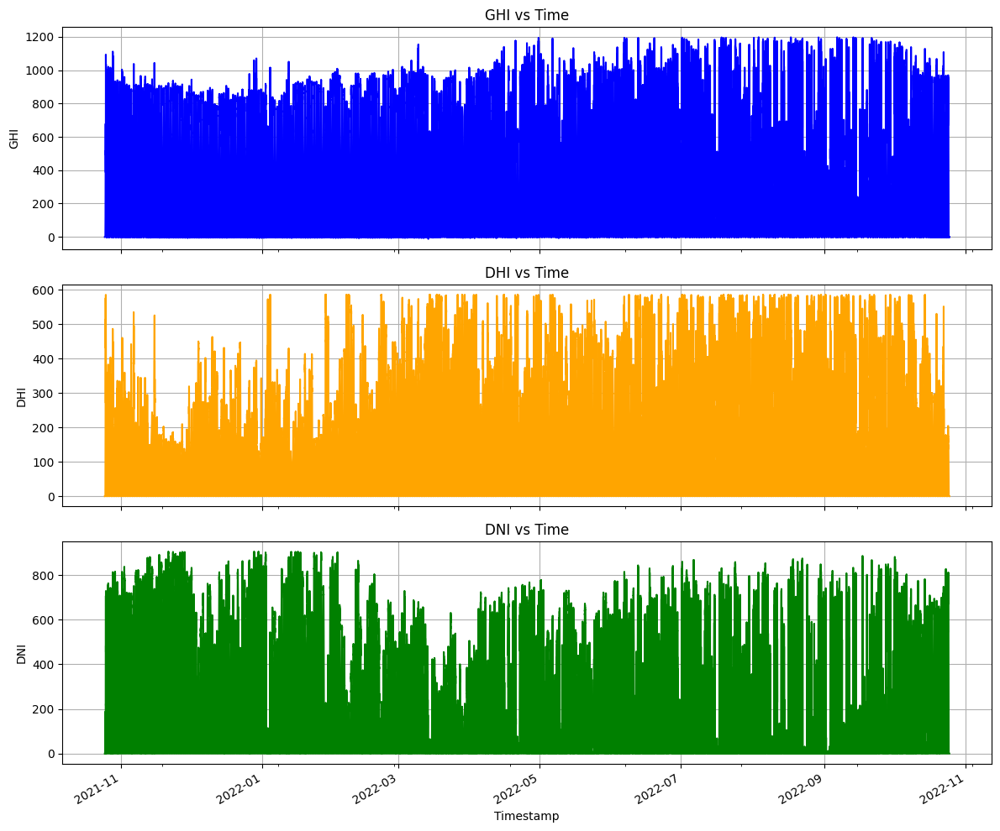

In [12]:
import pandas as pd
import matplotlib.pyplot as plt

data_frame.head()
data_frame.columns = data_frame.columns.str.strip()  # Strip whitespace from all column names

# Check for nulls and unique values
print("GHI column info:")
print(data_frame['GHI'].describe())
print("\nMissing values:", data_frame['GHI'].isnull().sum())
print("Unique values:", data_frame['GHI'].unique())

# Parse Timestamp and set as index
data_frame['Timestamp'] = pd.to_datetime(data_frame['Timestamp'])
data_frame.set_index('Timestamp', inplace=True)

# Plot each column separately
fig, axes = plt.subplots(3, 1, figsize=(12, 10), sharex=True)

data_frame['GHI'].plot(ax=axes[0], title='GHI vs Time', color='blue')
axes[0].set_ylabel('GHI')
axes[0].grid(True)

data_frame['DHI'].plot(ax=axes[1], title='DHI vs Time', color='orange')
axes[1].set_ylabel('DHI')
axes[1].grid(True)

data_frame['DNI'].plot(ax=axes[2], title='DNI vs Time', color='green')
axes[2].set_ylabel('DNI')
axes[2].set_xlabel('Timestamp')
axes[2].grid(True)

plt.tight_layout()
plt.show()


In [13]:
if 'CleanFlag' in data_frame.columns:
    cleaning_avg = data_frame.groupby('CleanFlag')[['ModA', 'ModB']].mean()
    cleaning_avg.plot(kind='bar', title='Cleaning Impact on ModA & ModB')
    plt.ylabel('Average Irradiance')
    plt.grid(True)
    plt.show()

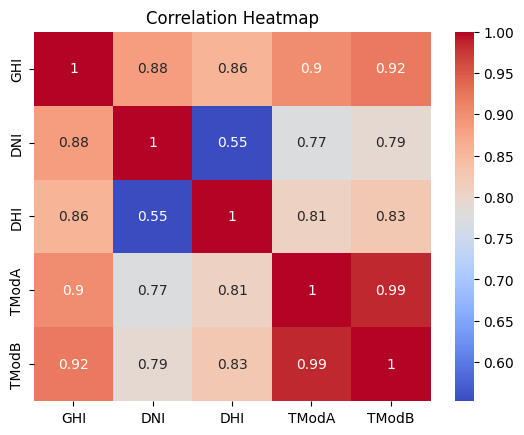

In [14]:
corr_cols = ['GHI', 'DNI', 'DHI', 'TModA', 'TModB']
heat_data = data_frame[[col for col in corr_cols if col in data_frame.columns]]
sns.heatmap(heat_data.corr(), annot=True, cmap='coolwarm')
plt.title("Correlation Heatmap")
plt.show()

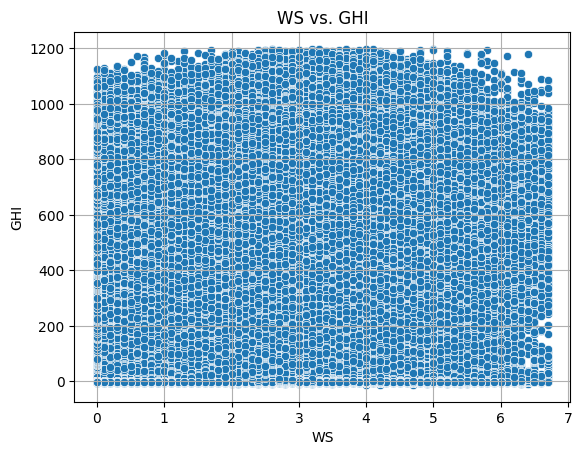

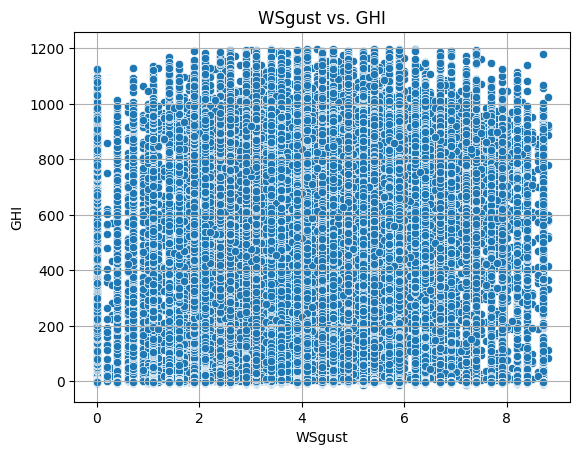

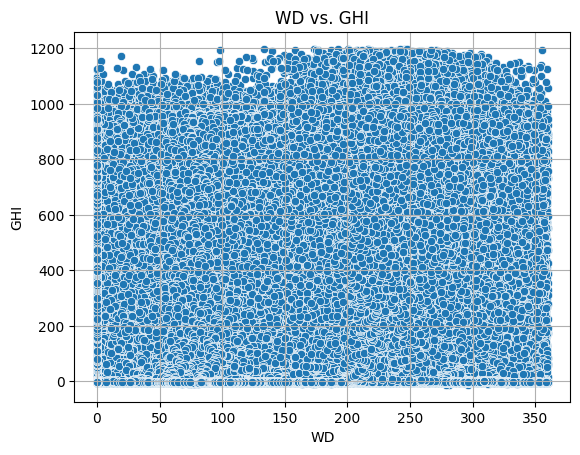

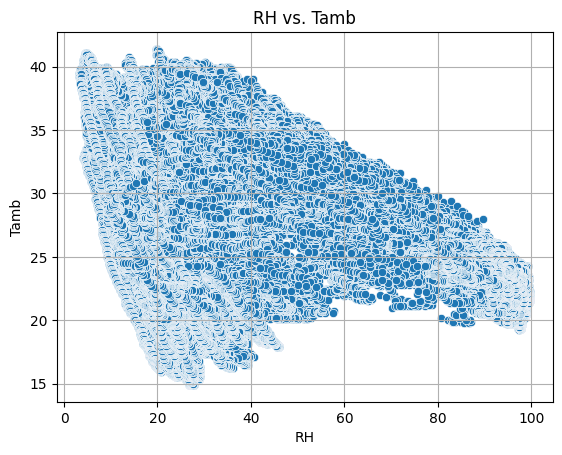

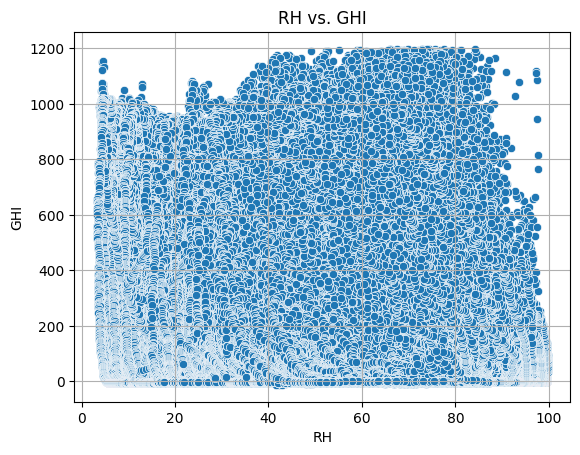

In [15]:
#  Scatter Plots
scatter_pairs = [('WS', 'GHI'), ('WSgust', 'GHI'), ('WD', 'GHI'), ('RH', 'Tamb'), ('RH', 'GHI')]

for x, y in scatter_pairs:
    if x in data_frame.columns and y in data_frame.columns:
        sns.scatterplot(data=data_frame, x=x, y=y)
        plt.title(f'{x} vs. {y}')
        plt.grid(True)
        plt.show()


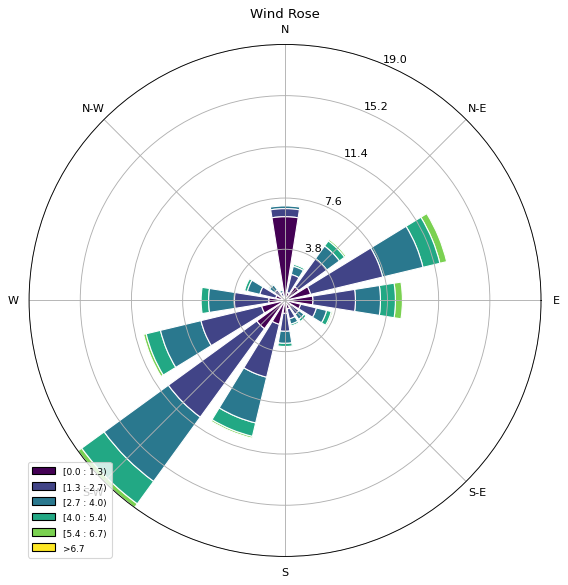

In [16]:
# Wind Rose
if 'WS' in data_frame.columns and 'WD' in data_frame.columns:
    ax = WindroseAxes.from_ax()
    ax.bar(data_frame['WD'], data_frame['WS'], normed=True, opening=0.8, edgecolor='white')
    ax.set_legend()
    plt.title('Wind Rose')
    plt.show()

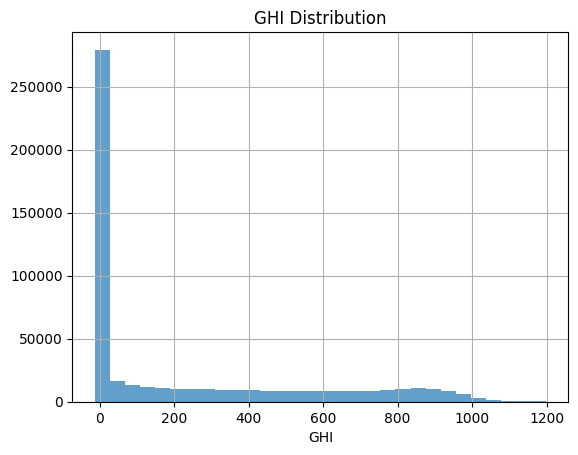

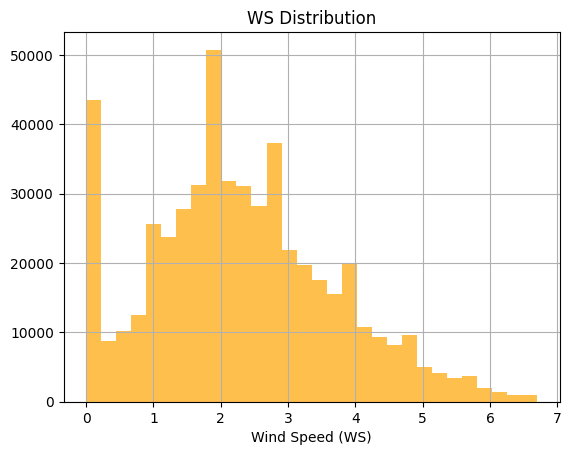

In [17]:
# Histograms

data_frame['GHI'].hist(bins=30, alpha=0.7)
plt.title("GHI Distribution")
plt.xlabel("GHI")
plt.grid(True)
plt.show()

if 'WS' in data_frame.columns:
    data_frame['WS'].hist(bins=30, alpha=0.7, color='orange')
    plt.title("WS Distribution")
    plt.xlabel("Wind Speed (WS)")
    plt.grid(True)
    plt.show()

In [18]:
# Bubble Chart
size_col = 'RH' if 'RH' in data_frame.columns else 'BP' if 'BP' in data_frame.columns else None

if 'GHI' in data_frame.columns and 'Tamb' in data_frame.columns and size_col:
    fig = px.scatter(
        data_frame.reset_index(), x='Tamb', y='GHI',
        size=size_col,
        color=size_col,
        title=f'Bubble Chart: GHI vs. Tamb (Bubble = {size_col})',
        labels={'Tamb': 'Temperature Ambient', 'GHI': 'Global Horizontal Irradiance'}
    )
    fig.show()